In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F

import torchvision.transforms as transforms
from PIL import Image
import numpy as np
import cv2
import os
import matplotlib.pyplot as plt
from facenet_pytorch import MTCNN
from tqdm import tqdm

from models import StackedHourglass, get_recognition_model
from defenitions import dst_points

In [2]:
# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device = 'cpu'
print(f"Используется устройство: {device}")

mtcnn = MTCNN(image_size=160, margin=14, device=device, post_process=False)

alignment_model = StackedHourglass(num_outputs=5, feature_size=32)
alignment_model.load_state_dict(torch.load('./models/working_aligner.pth', map_location=device)) 
alignment_model.to(device)
alignment_model.eval()

recognition_model = get_recognition_model(embedding_size=512)
recognition_model.load_state_dict(torch.load('./models/train_serious.pth', map_location=device)['model_state_dict'])
recognition_model.to(device)
recognition_model.eval();


Используется устройство: cpu


In [3]:
def align_face(image_pil, src_points, output_size=(128, 128)):
    image_bgr = cv2.cvtColor(np.array(image_pil), cv2.COLOR_RGB2BGR)

    M, _ = cv2.estimateAffine2D(src_points.astype(np.float32), dst_points, method=cv2.RANSAC)

    return cv2.warpAffine(image_bgr, M, output_size, borderMode=cv2.BORDER_REPLICATE)

def get_embeddings_from_image(image_path, mtcnn, alignment_model, recognition_model, device):
    try:
        img_pil = Image.open(image_path).convert('RGB')
    except FileNotFoundError:
        print(f"Файл не найден: {image_path}")
        return [], []

    boxes, _ = mtcnn.detect(img_pil)
    if boxes is None:
        print(f"Лица не найдены на {os.path.basename(image_path)}")
        return [], []

    final_embeddings = []
    aligned_faces = []

    transform_align = transforms.Compose([transforms.Resize((128, 128)), transforms.ToTensor()])
    transform_rec = transforms.Compose([
        transforms.ToTensor(),
    ])

    for box in boxes:
        face_pil = img_pil.crop(box)
        
        face_tensor = transform_align(face_pil).unsqueeze(0).to(device)
        with torch.no_grad():
            pred_heatmaps = alignment_model(face_tensor)[-1][0]
        
        pred_coords = []
        face_w, face_h = face_pil.size
        for i in range(pred_heatmaps.shape[0]):
            hm = pred_heatmaps[i].cpu().numpy()
            y, x = np.unravel_index(np.argmax(hm), hm.shape)
            pred_coords.append([x * face_w / 128, y * face_h / 128])
        pred_coords = np.array(pred_coords)

        face_cv = cv2.cvtColor(np.array(face_pil), cv2.COLOR_RGB2BGR)
        aligned_cv = align_face(face_cv, pred_coords, output_size=(128, 128))
        aligned_pil = Image.fromarray(cv2.cvtColor(aligned_cv, cv2.COLOR_BGR2RGB))
        aligned_faces.append(aligned_pil)

        rec_tensor = transform_rec(aligned_pil).unsqueeze(0).to(device)
        with torch.no_grad():
            embedding = recognition_model(rec_tensor)
        
        embedding = F.normalize(embedding, p=2, dim=1)
        final_embeddings.append(embedding)

    return final_embeddings, aligned_faces

print("Функция пайплайна готова к использованию.")

Функция пайплайна готова к использованию.


Тест 1: Сравнение двух фото одного человека


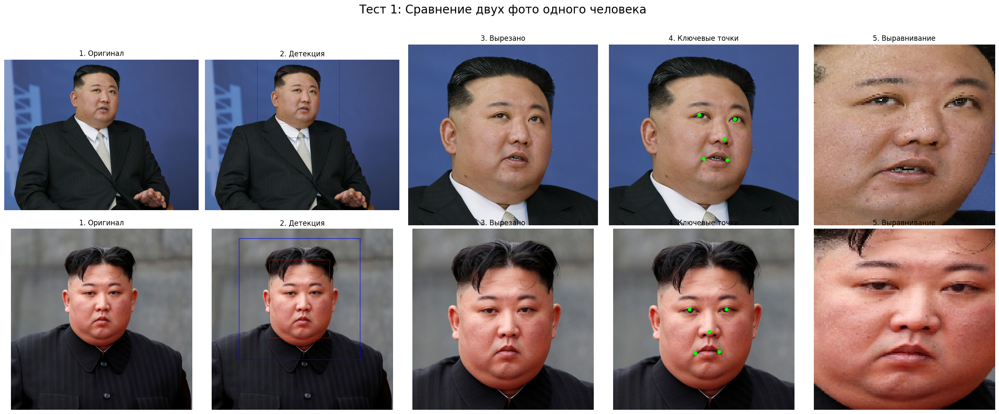

--- Сырые эмбеддинги (первые 12 значений) ---
Эмбеддинг 1: [ 0.03697649  0.04716284  0.00956002  0.00147507 -0.05290614  0.08243786
 -0.05892094  0.06888159  0.05350418  0.07004301  0.04182962 -0.05128473]
Эмбеддинг 2: [ 0.03717468  0.04698978  0.00955248  0.00147217 -0.05272415  0.0781208
 -0.05895288  0.06973918  0.05382946  0.06573398  0.04747184 -0.05130122]

--- Итог ---
Косинусное сходство: 0.9992
✅ ВЕРДИКТ: ОДИН И ТОТ ЖЕ ЧЕЛОВЕК (сходство > 0.95)


Тест 2: Сравнение фото разных людей


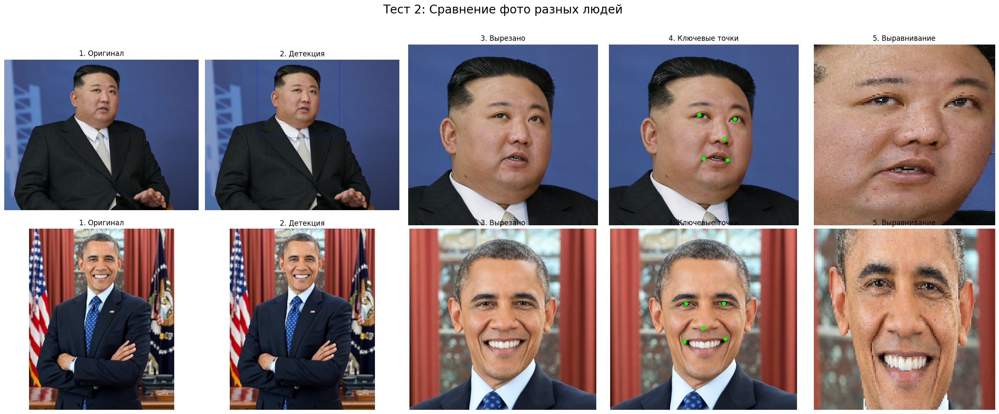

--- Сырые эмбеддинги (первые 12 значений) ---
Эмбеддинг 1: [ 0.03697649  0.04716284  0.00956002  0.00147507 -0.05290614  0.08243786
 -0.05892094  0.06888159  0.05350418  0.07004301  0.04182962 -0.05128473]
Эмбеддинг 2: [ 0.03794055  0.04843435  0.00971565  0.00150241 -0.05258435  0.08171498
 -0.05940896  0.04825798  0.06687695  0.05232652  0.05359421 -0.05041823]

--- Итог ---
Косинусное сходство: 0.9299
❌ ВЕРДИКТ: РАЗНЫЕ ЛЮДИ (сходство <= 0.95)




In [4]:
from PIL import ImageDraw

def expand_box_to_square(box, image_width, image_height, margin_factor=0.55):
    x1, y1, x2, y2 = box
    width = x2 - x1
    height = y2 - y1
    
    center_x = x1 + width / 2
    center_y = y1 + height / 2
    side_length = max(width, height)
    
    new_side_length = side_length * (1 + margin_factor)
    half_side = new_side_length / 2
    
    new_x1 = max(0, center_x - half_side)
    new_y1 = max(0, center_y - half_side)
    new_x2 = min(image_width, center_x + half_side)
    new_y2 = min(image_height, center_y + half_side)
    
    return [new_x1, new_y1, new_x2, new_y2]


def run_pipeline_and_visualize(image_path, mtcnn, alignment_model, recognition_model, device):
    try:
        original_pil = Image.open(image_path).convert('RGB')
    except FileNotFoundError:
        print(f"Файл не найден: {image_path}")
        return None, {}

    viz_images = {'original': original_pil}

    boxes, _ = mtcnn.detect(original_pil)
    if boxes is None:
        print(f"Лица не найдены на {os.path.basename(image_path)}")
        return None, viz_images

    original_box = boxes[0]
    img_w, img_h = original_pil.size
    expanded_box = expand_box_to_square(original_box, img_w, img_h)

    detected_pil = original_pil.copy()
    draw = ImageDraw.Draw(detected_pil)
    draw.rectangle(original_box.tolist(), outline="red", width=2) 
    draw.rectangle(expanded_box, outline="blue", width=3)
    viz_images['detected'] = detected_pil
    
    face_pil = original_pil.crop(expanded_box)
    viz_images['cropped'] = face_pil

    transform_align = transforms.Compose([transforms.Resize((128, 128)), transforms.ToTensor()])
    face_tensor = transform_align(face_pil).unsqueeze(0).to(device)
    with torch.no_grad():
        pred_heatmaps = alignment_model(face_tensor)[-1][0]
    
    pred_coords = []
    face_w, face_h = face_pil.size
    for i in range(pred_heatmaps.shape[0]):
        hm = pred_heatmaps[i].cpu().numpy()
        y, x = np.unravel_index(np.argmax(hm), hm.shape)
        pred_coords.append([x * face_w / 128, y * face_h / 128])
    pred_coords = np.array(pred_coords)

    keypoints_pil = face_pil.copy()
    draw_kp = ImageDraw.Draw(keypoints_pil)
    for (px, py) in pred_coords:
        draw_kp.ellipse([px-(face_w/100), py-(face_w/100), px+(face_w/100), py+(face_w/100)], fill='lime', outline='lime')
    viz_images['keypoints'] = keypoints_pil

    aligned_cv = align_face(face_pil, pred_coords, output_size=(128, 128))
    aligned_pil = Image.fromarray(cv2.cvtColor(aligned_cv, cv2.COLOR_BGR2RGB))
    viz_images['aligned'] = aligned_pil

    transform_rec = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
    ])
    rec_tensor = transform_rec(aligned_pil).unsqueeze(0).to(device)
    with torch.no_grad():
        embedding = recognition_model(rec_tensor)
    embedding = F.normalize(embedding, p=2, dim=1)
    
    return embedding, viz_images

def compare_images(path1, path2, title, threshold):
    print(title)
    emb1, viz1 = run_pipeline_and_visualize(path1, mtcnn, alignment_model, recognition_model, device)
    emb2, viz2 = run_pipeline_and_visualize(path2, mtcnn, alignment_model, recognition_model, device)
    
    if not viz1 or not viz2:
        print("Не удалось обработать одно из изображений. Сравнение невозможно.")
        return

    fig, axes = plt.subplots(2, 5, figsize=(24, 10))
    fig.suptitle(title, fontsize=20)
    
    img_keys = ['original', 'detected', 'cropped', 'keypoints', 'aligned']
    titles = ['1. Оригинал', '2. Детекция', '3. Вырезано', '4. Ключевые точки', '5. Выравнивание']
    
    for ax, img_key, title_text in zip(axes[0], img_keys, titles):
        ax.imshow(viz1.get(img_key))
        ax.set_title(title_text)
        ax.axis('off')
    
    for ax, img_key, title_text in zip(axes[1], img_keys, titles):
        ax.imshow(viz2.get(img_key))
        ax.set_title(title_text)
        ax.axis('off')
        
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()

    if emb1 is None or emb2 is None:
        print("\n--- Итог ---")
        print("Не удалось получить эмбеддинги для одного или обоих изображений.")
        return

    print("--- Сырые эмбеддинги (первые 12 значений) ---")
    print(f"Эмбеддинг 1: {emb1[0, :12].cpu().numpy()}")
    print(f"Эмбеддинг 2: {emb2[0, :12].cpu().numpy()}")
    
    similarity = F.cosine_similarity(emb1, emb2).item()
    print(f"\n--- Итог ---")
    print(f"Косинусное сходство: {similarity:.4f}")

    if similarity > threshold:
        print(f"✅ ВЕРДИКТ: ОДИН И ТОТ ЖЕ ЧЕЛОВЕК (сходство > {threshold})")
    else:
        print(f"❌ ВЕРДИКТ: РАЗНЫЕ ЛЮДИ (сходство <= {threshold})")
    print("\n" + "="*70 + "\n")


IMAGE_SAME_PERSON_1 = 'test_images/kim1.jpg'
IMAGE_SAME_PERSON_2 = 'test_images/kim2.jpg'
IMAGE_DIFFERENT_PERSON = 'test_images/obama1.jpg'
SIMILARITY_THRESHOLD = 0.95 

compare_images(IMAGE_SAME_PERSON_1, IMAGE_SAME_PERSON_2, 
               title="Тест 1: Сравнение двух фото одного человека",
               threshold=SIMILARITY_THRESHOLD)

compare_images(IMAGE_SAME_PERSON_1, IMAGE_DIFFERENT_PERSON, 
               title="Тест 2: Сравнение фото разных людей",
               threshold=SIMILARITY_THRESHOLD)

--- Шаг 1: Поиск и обработка всех изображений в папке 'test_images' ---


Обработка изображений: 100%|██████████| 23/23 [00:07<00:00,  3.28it/s]




--- Шаг 2: Визуализация результатов по этапам ---


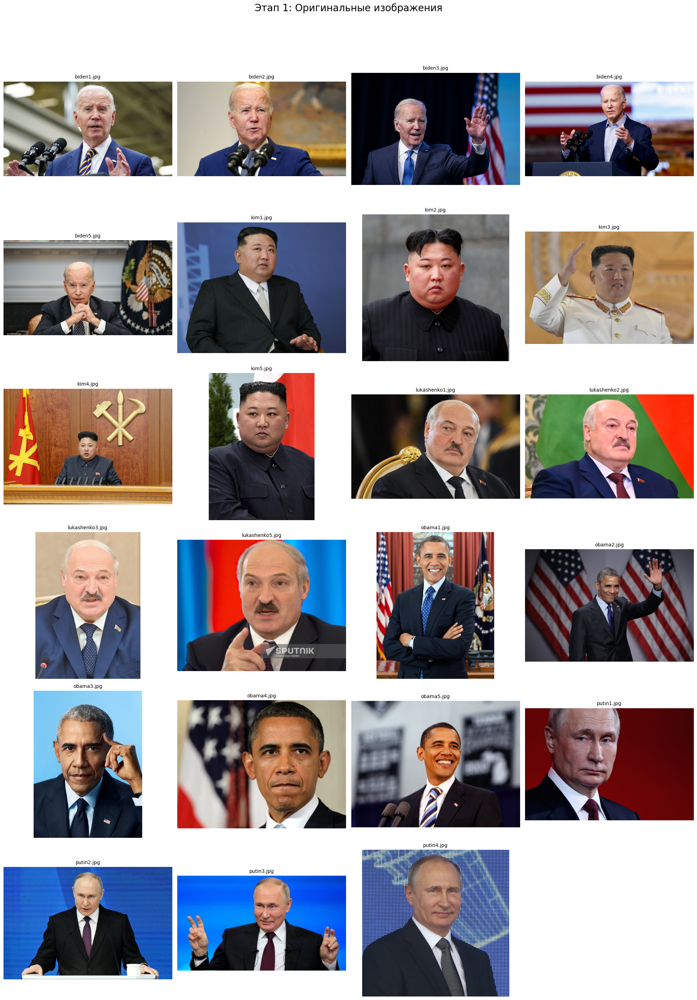

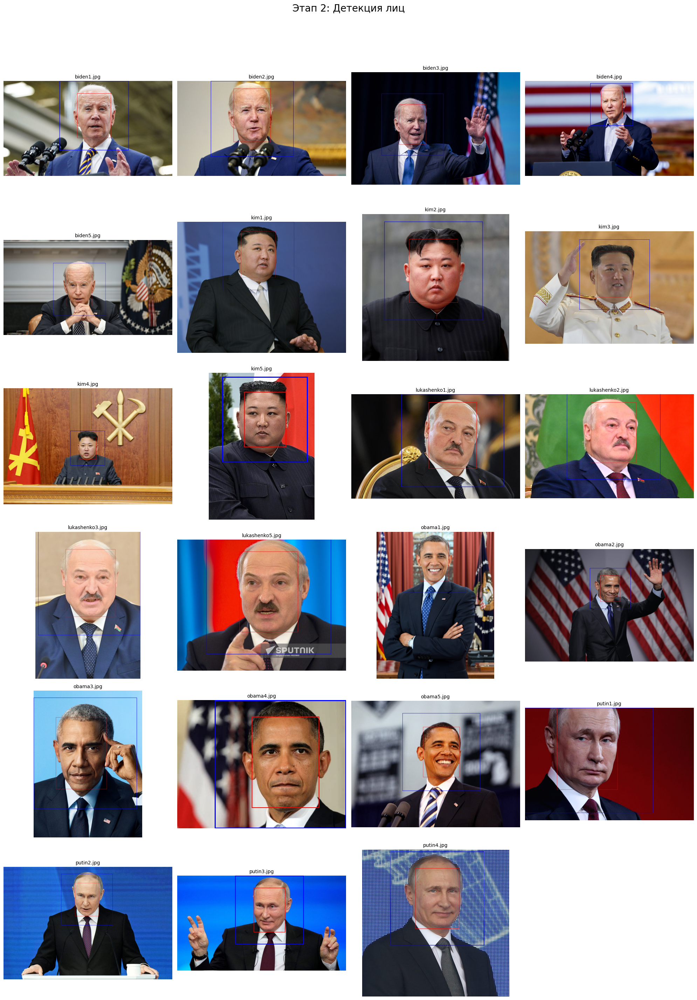

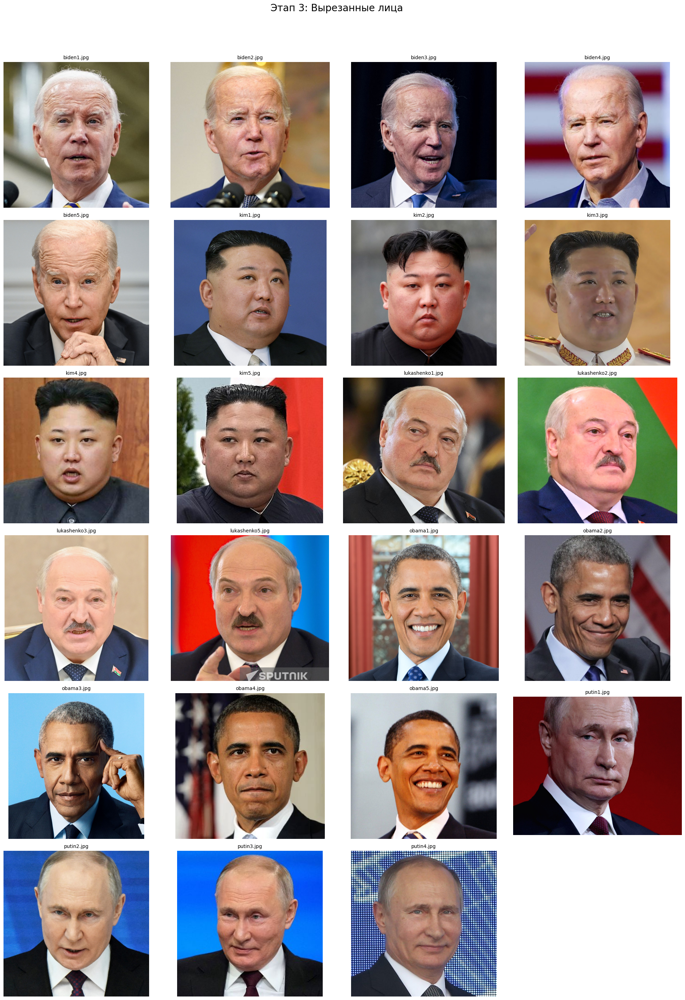

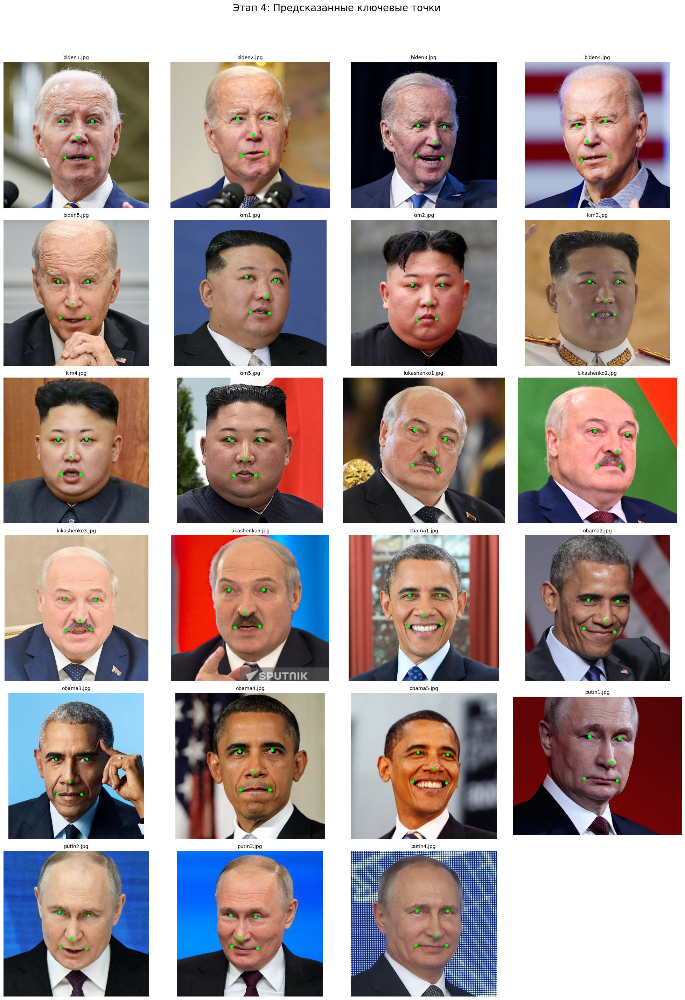

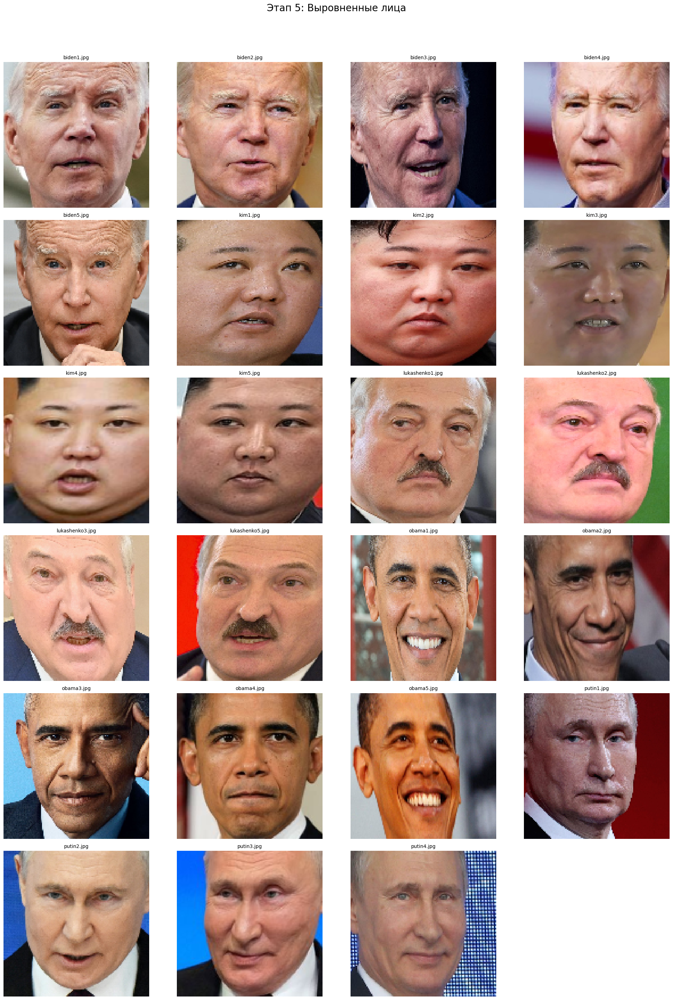



--- Шаг 3: Итоговая матрица схожести для 23 изображений ---


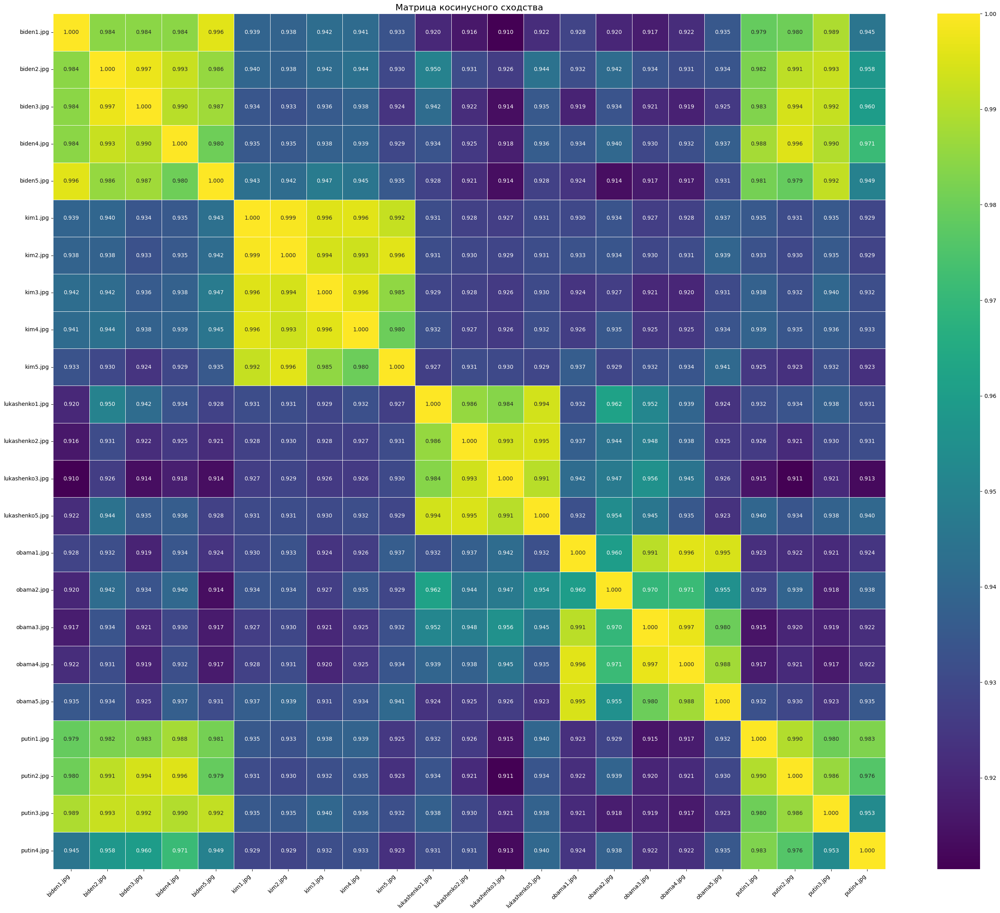

In [5]:
import glob
import seaborn as sns
from itertools import combinations
import math

COMPARISON_FOLDER = 'test_images' 
GALLERY_COLS = 4

def run_folder_analysis_by_stage(folder_path):
    """
    Выполняет анализ папки с изображениями и представляет результаты по этапам:
    1. Обрабатывает все изображения для получения эмбеддингов и шагов визуализации.
    2. Для каждого этапа (оригинал, детекция и т.д.) создает отдельную галерею
       со всеми изображениями на этом этапе.
    3. Строит итоговую матрицу схожести для всех изображений.
    """
    
    print(f"--- Шаг 1: Поиск и обработка всех изображений в папке '{folder_path}' ---")

    image_paths = sorted(glob.glob(os.path.join(folder_path, '*.jpg')) + \
                         glob.glob(os.path.join(folder_path, '*.png')))

    processed_data = {}
    for path in tqdm(image_paths, desc="Обработка изображений"):
        embedding, viz_images = run_pipeline_and_visualize(
            path, mtcnn, alignment_model, recognition_model, device
        )
        if embedding is not None:
            processed_data[path] = {'embedding': embedding, 'viz': viz_images}
        else:
            print(f"Предупреждение: не удалось обработать {os.path.basename(path)}, изображение будет пропущено.")

    valid_paths = list(processed_data.keys())
    n_images = len(valid_paths)

    if n_images < 1:
        print("\nВ папке не найдено валидных изображений для анализа.")
        return

    print(f"\n\n--- Шаг 2: Визуализация результатов по этапам ---")
    
    stage_keys = ['original', 'detected', 'cropped', 'keypoints', 'aligned']
    stage_titles = ['Этап 1: Оригинальные изображения', 
                    'Этап 2: Детекция лиц', 
                    'Этап 3: Вырезанные лица', 
                    'Этап 4: Предсказанные ключевые точки', 
                    'Этап 5: Выровненные лица']

    for i, key in enumerate(stage_keys):
        rows = math.ceil(n_images / GALLERY_COLS)
        fig, axes = plt.subplots(rows, GALLERY_COLS, figsize=(GALLERY_COLS * 5, rows * 5))
        fig.suptitle(stage_titles[i], fontsize=20)
        
        axes = axes.flatten()

        for j, path in enumerate(valid_paths):
            ax = axes[j]
            img = processed_data[path]['viz'].get(key)
            if img:
                ax.imshow(img)
            ax.set_title(os.path.basename(path), fontsize=10)
            ax.axis('off')

        for j in range(n_images, len(axes)):
            axes[j].axis('off')
            
        plt.tight_layout(rect=[0, 0.03, 1, 0.95])
        plt.show()
    
    if n_images < 2:
        print("\nНайдено менее двух валидных изображений. Матрица схожести не будет построена.")
        return

    print(f"\n\n--- Шаг 3: Итоговая матрица схожести для {n_images} изображений ---")
    
    similarity_matrix = np.eye(n_images)
    
    for i_idx, j_idx in combinations(range(n_images), 2):
        emb1 = processed_data[valid_paths[i_idx]]['embedding']
        emb2 = processed_data[valid_paths[j_idx]]['embedding']
        similarity = F.cosine_similarity(emb1, emb2).item()
        similarity_matrix[i_idx, j_idx] = similarity_matrix[j_idx, i_idx] = similarity

    plt.figure(figsize=(max(8, n_images * 1.2), max(6, n_images)))
    labels = [os.path.basename(p) for p in valid_paths]
    
    sns.heatmap(
        similarity_matrix,
        annot=True,          
        fmt=".3f",           
        cmap='viridis',      
        xticklabels=labels,
        yticklabels=labels,
        linewidths=.5
    )
    plt.title("Матрица косинусного сходства", fontsize=16)
    plt.xticks(rotation=45, ha='right')
    plt.yticks(rotation=0)
    plt.tight_layout()
    plt.show()

run_folder_analysis_by_stage(COMPARISON_FOLDER)